###Import the Modules

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

# Path to the zipped folder containing anime face images
anime_zip_path = '/content/drive/MyDrive/anime_faces.zip'

# from google.colab import files
# uploaded = files.upload()

Mounted at /content/drive


In [ ]:
import os
import numpy as np
import matplotlib.pyplot as plt
import warnings

from tqdm.notebook import tqdm

import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.models import load_model
from tensorflow.keras.preprocessing.image import load_img, array_to_img
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras import layers
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.losses import BinaryCrossentropy

from Discriminator import Discriminator
from Generator import Generator
from DCGAN import DCGAN
from DCGANMonitor import DCGANMonitor

warnings.filterwarnings('ignore')

In [ ]:
!pip install patool

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 77.5/77.5 kB 4.1 MB/s eta 0:00:00


In [ ]:
import patoolib
patoolib.extract_archive(anime_zip_path, outdir = '/content/Anime_Faces')

patool: Extracting /content/drive/MyDrive/anime_faces.zip ...
patool: running /usr/bin/7z x -o/content/Anime_Faces -- /content/drive/MyDrive/anime_faces.zip
patool: ... /content/drive/MyDrive/anime_faces.zip extracted to `/content/Anime_Faces'.


'/content/Anime_Faces'

In [ ]:
# Counting the number of files in the 'Anime_Faces/data' directory.
!ls Anime_Faces/data -1 | wc -l

21552


###Load the files

In [ ]:
# Defining the base directory for the anime face dataset.
BASE_DIR = 'Anime_Faces/data'

In [ ]:
# load complete image paths to the list
image_paths = []
for image_name in os.listdir(BASE_DIR):
    image_path = os.path.join(BASE_DIR, image_name)
    image_paths.append(image_path)

In [ ]:
# Selecting the first five file paths in the list of image paths.
image_paths[:5]

['Anime_Faces/data/18056.png',
 'Anime_Faces/data/21240.png',
 'Anime_Faces/data/7451.png',
 'Anime_Faces/data/16016.png',
 'Anime_Faces/data/15519.png']

In [ ]:
# remove unnecessary file
image_paths.remove('Anime_Faces/data/data')

In [ ]:
# Returns the total number of image files in the dataset.
len(image_paths)

21551

###Visualize the dataset

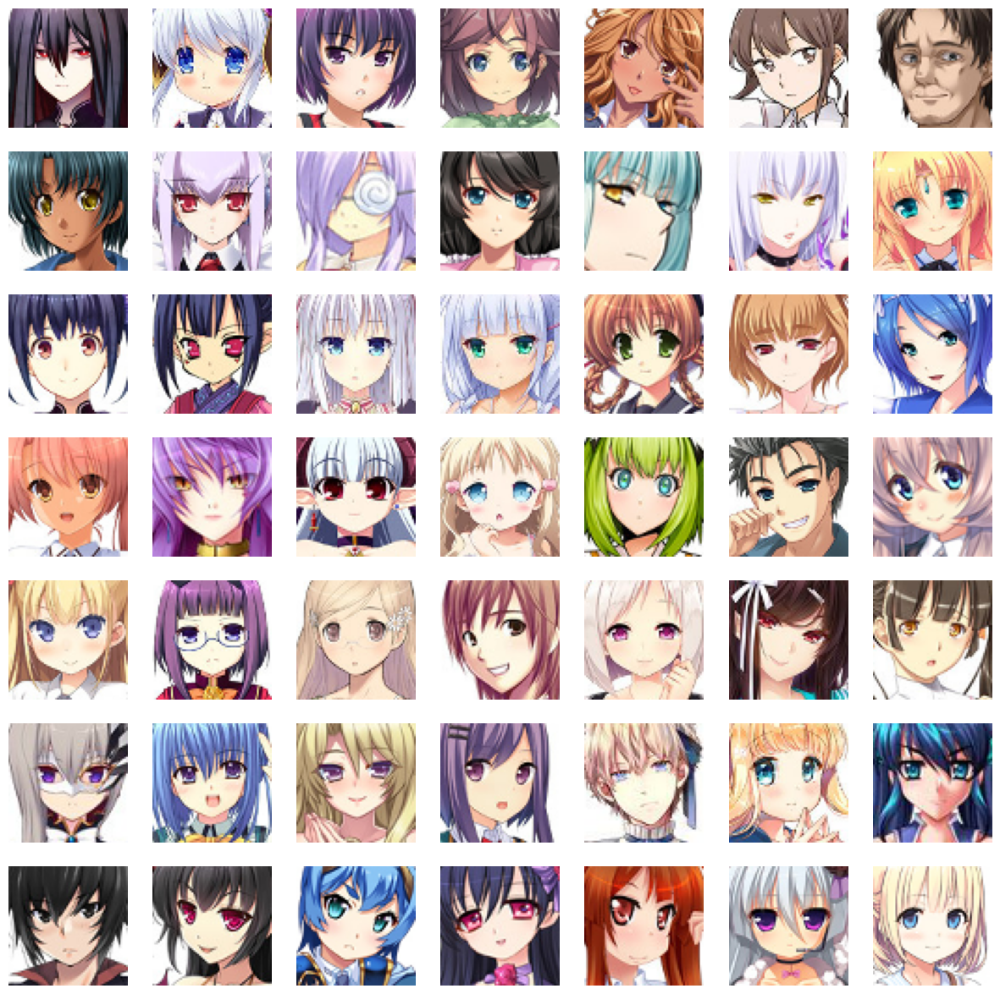

In [ ]:
# to display grid of images (7x7)

# Create a 15x15 inch figure for displaying sample images
plt.figure(figsize=(15, 15))

# Select the first 49 image paths to display
sample_images = image_paths[:49]

# Initialize the index to 1
image_index = 1

# Iterate over each image path in the sample
for image_path in sample_images:
    # Define a subplot in a 7x7 grid
    plt.subplot(7, 7, image_index)

    # Load the image from the path
    image = load_img(image_path)

    # Convert the image to a numpy array
    image_array = np.array(image)

    # Display the image
    plt.imshow(image_array)

    # Hide the axis labels
    plt.axis('off')

    # Increment the index to move to the next subplot
    image_index += 1

###Preprocess Images

In [ ]:
#Load and convert training images to a numpy array
train_images = [np.array(load_img(path)) for path in tqdm(image_paths)]
train_images = np.array(train_images)

  0%|          | 0/21551 [00:00<?, ?it/s]

In [ ]:
#Code retrieves the shape of the first image in the training set.
train_images[0].shape

(64, 64, 3)

In [ ]:
# Reshape the array
reshaped_images = train_images.reshape(train_images.shape[0], 64, 64, 3).astype('float32')

# Normalize the images
normalized_images = (reshaped_images - 127.5) / 127.5

# Display the first normalized image
normalized_images[0]

array([[[ 1.        ,  1.        ,  0.9764706 ],
        [ 1.        ,  1.        ,  1.        ],
        [-0.06666667, -0.25490198, -0.05882353],
        ...,
        [-0.40392157, -0.5137255 , -0.4117647 ],
        [-0.41960785, -0.54509807, -0.44313726],
        [-0.41960785, -0.56078434, -0.4509804 ]],

       [[ 1.        ,  1.        ,  1.        ],
        [ 0.42745098,  0.40392157,  0.44313726],
        [-0.15294118, -0.35686275, -0.12941177],
        ...,
        [-0.40392157, -0.5137255 , -0.4117647 ],
        [-0.4117647 , -0.5372549 , -0.43529412],
        [-0.3647059 , -0.5058824 , -0.39607844]],

       [[ 1.        ,  1.        ,  1.        ],
        [-0.13725491, -0.20784314, -0.11372549],
        [-0.12156863, -0.31764707, -0.06666667],
        ...,
        [-0.40392157, -0.52156866, -0.41960785],
        [-0.41960785, -0.54509807, -0.44313726],
        [-0.35686275, -0.49803922, -0.3882353 ]],

       ...,

       [[-0.84313726, -0.8901961 , -0.88235295],
        [-0

In [ ]:
# set the dimension of the random noise
latent_dimension = 100

# initialize weights using normal distribution with mean=0, stddev=0.02
weight_init = keras.initializers.RandomNormal(mean=0.0, stddev=0.02)

# set the number of channels for the images
num_channels = 3 # set to 1 for grayscale images

# instantiate generator and discriminator objects with above parameters
generator_object = Generator(latent_dimension, weight_init, num_channels)
generator = generator_object.create_model()

# print the summary of the generator model
print(generator.summary())

# print a separator line for clarity
print('-'*100)

# instantiate discriminator object with above parameters
discriminator_object = Discriminator(latent_dimension, weight_init, num_channels)
discriminator = discriminator_object.create_model()

# print the summary of the discriminator model
print(discriminator.summary())

Model: "generator"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 32768)             3309568   
                                                                 
 re_lu (ReLU)                (None, 32768)             0         
                                                                 
 reshape (Reshape)           (None, 8, 8, 512)         0         
                                                                 
 conv2d_transpose (Conv2DTra  (None, 16, 16, 256)      2097408   
 nspose)                                                         
                                                                 
 re_lu_1 (ReLU)              (None, 16, 16, 256)       0         
                                                                 
 conv2d_transpose_1 (Conv2DT  (None, 32, 32, 128)      524416    
 ranspose)                                               

In [ ]:
# Create an instance of DCGAN with specified generator, discriminator and latent dimension
dcgan_model = DCGAN(generator=generator, discriminator=discriminator, latent_dim=latent_dimension)

# Set the learning rates for generator and discriminator
D_LR = 0.0001
G_LR = 0.0003

# Compile the DCGAN with Adam optimizer and Binary Crossentropy loss function
dcgan_model.compile(g_optimizer=Adam(learning_rate=G_LR, beta_1=0.5), d_optimizer=Adam(learning_rate=D_LR, beta_1=0.5), loss_fn=BinaryCrossentropy())

Epoch 1/50
674/674 [==============================] - ETA: 0s - d_loss: 0.6803 - g_loss: 2.6534

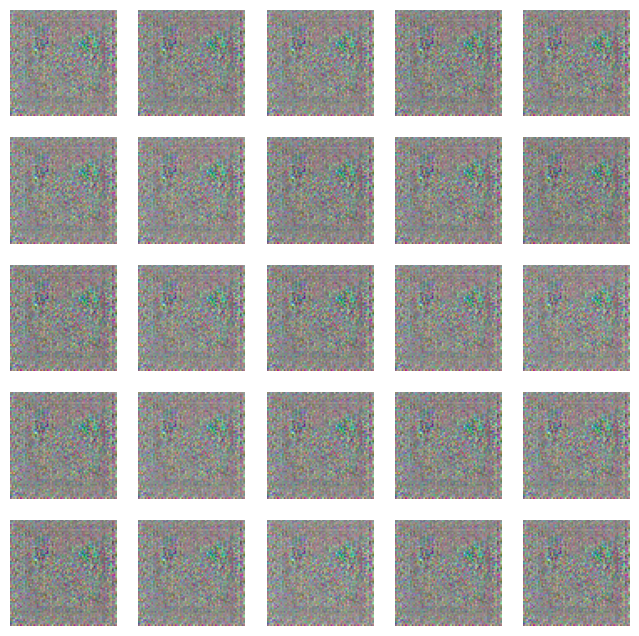

674/674 [==============================] - 58s 64ms/step - d_loss: 0.6803 - g_loss: 2.6534
Epoch 2/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.4282 - g_loss: 2.3496

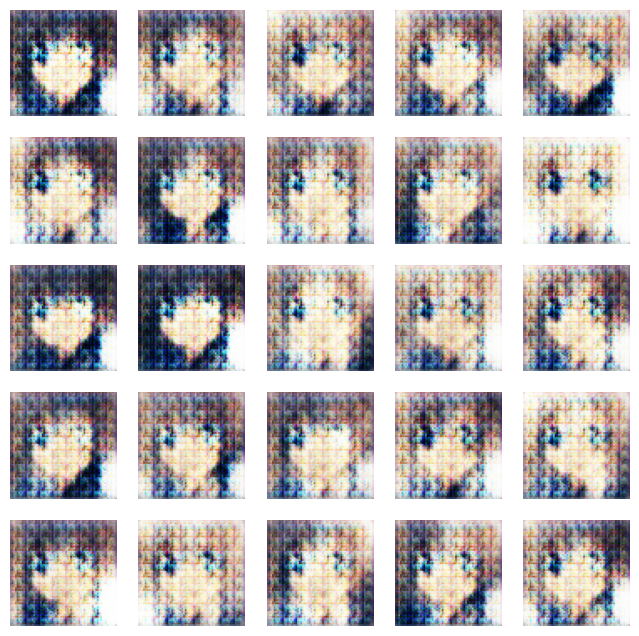

674/674 [==============================] - 45s 67ms/step - d_loss: 0.4285 - g_loss: 2.3469
Epoch 3/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.5931 - g_loss: 1.7099

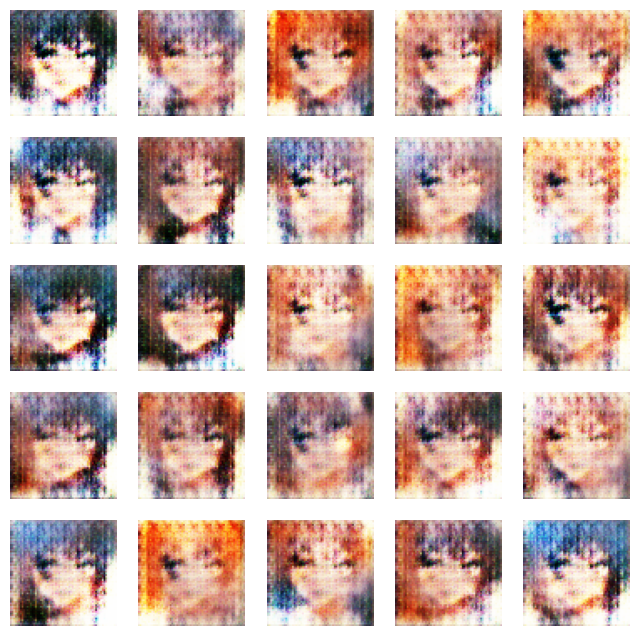

674/674 [==============================] - 45s 67ms/step - d_loss: 0.5927 - g_loss: 1.7108
Epoch 4/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6148 - g_loss: 1.6175

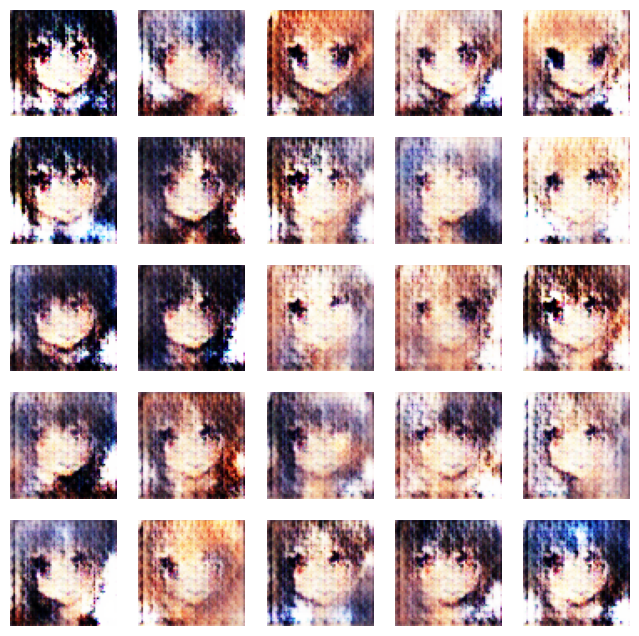

674/674 [==============================] - 45s 67ms/step - d_loss: 0.6148 - g_loss: 1.6174
Epoch 5/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6266 - g_loss: 1.5818

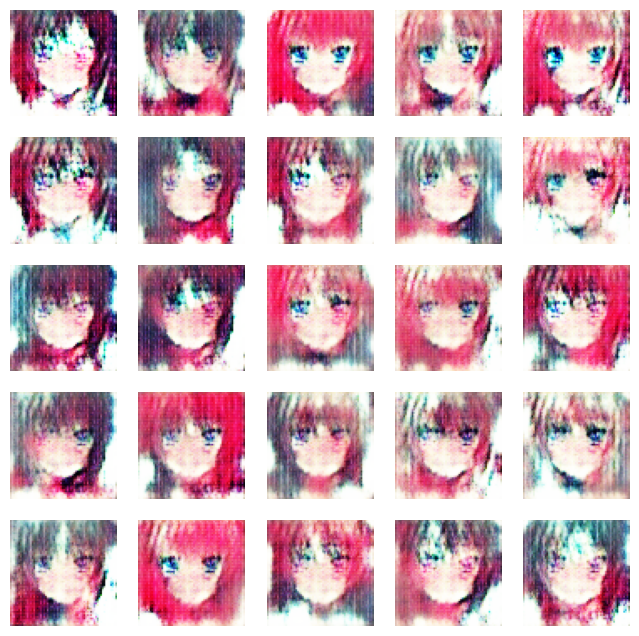

674/674 [==============================] - 45s 67ms/step - d_loss: 0.6265 - g_loss: 1.5826
Epoch 6/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6211 - g_loss: 1.5360

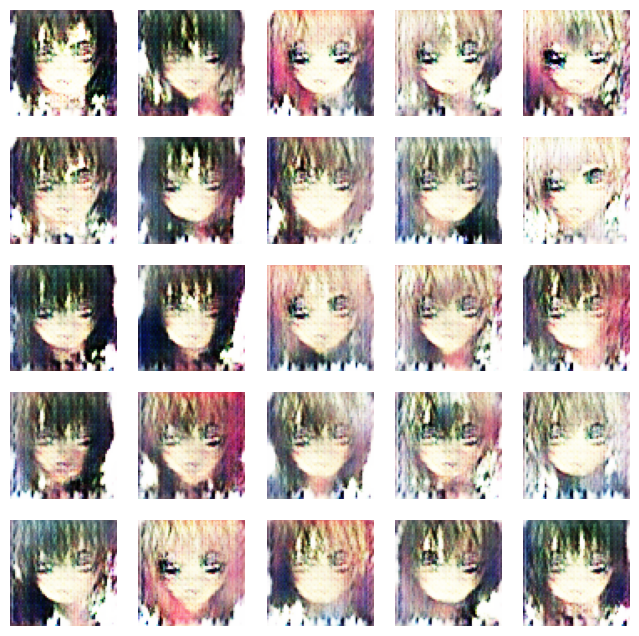

674/674 [==============================] - 45s 67ms/step - d_loss: 0.6209 - g_loss: 1.5359
Epoch 7/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6313 - g_loss: 1.4298

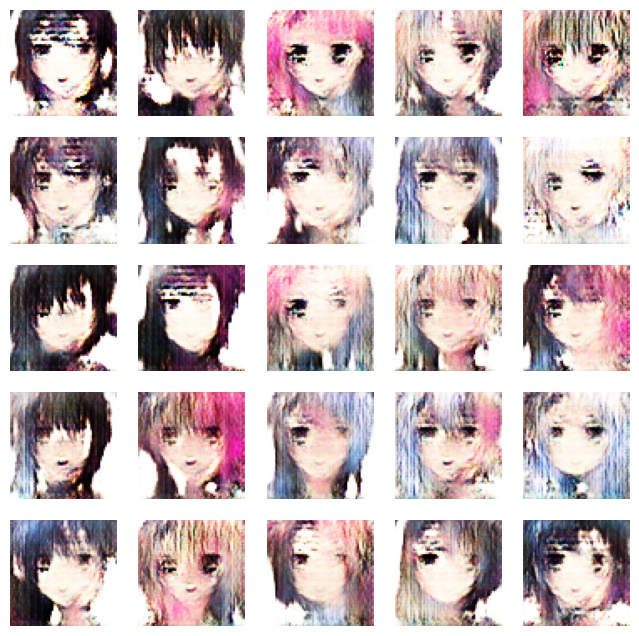

674/674 [==============================] - 46s 68ms/step - d_loss: 0.6310 - g_loss: 1.4300
Epoch 8/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6003 - g_loss: 1.4433

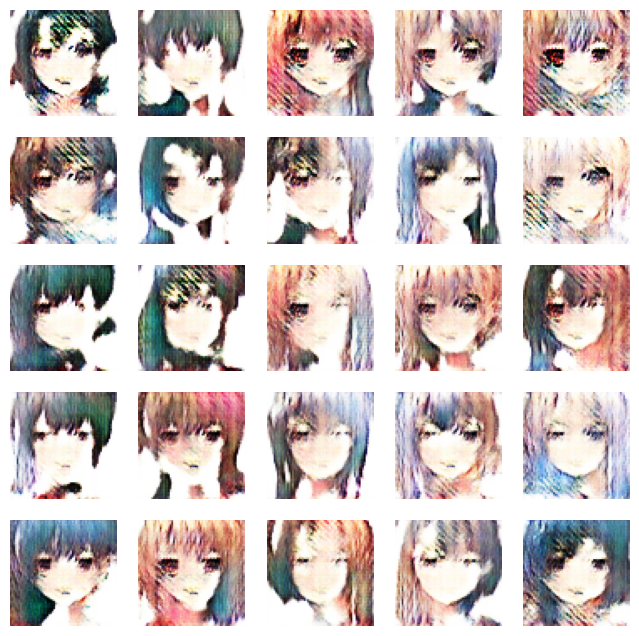

674/674 [==============================] - 45s 67ms/step - d_loss: 0.6003 - g_loss: 1.4434
Epoch 9/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.5860 - g_loss: 1.4926

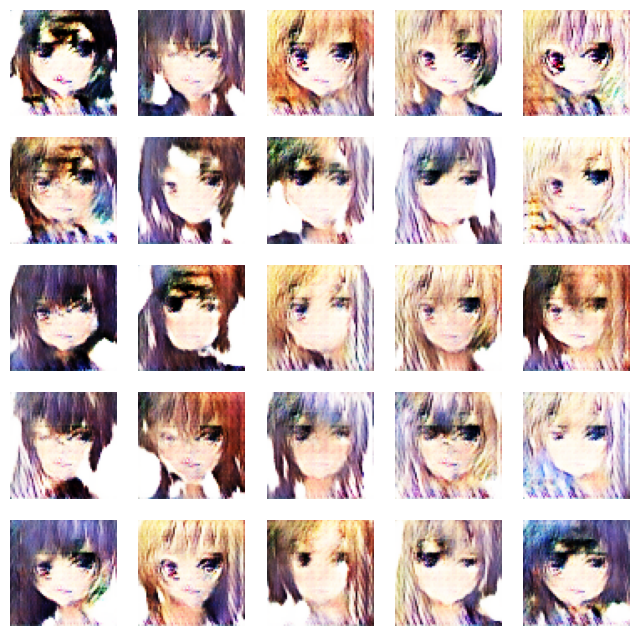

674/674 [==============================] - 46s 68ms/step - d_loss: 0.5860 - g_loss: 1.4928
Epoch 10/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6012 - g_loss: 1.3656

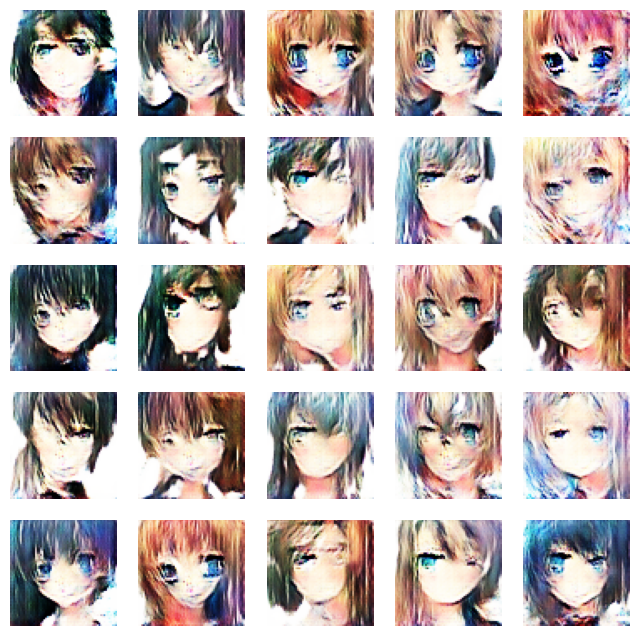

674/674 [==============================] - 46s 68ms/step - d_loss: 0.6014 - g_loss: 1.3655
Epoch 11/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6626 - g_loss: 1.1579

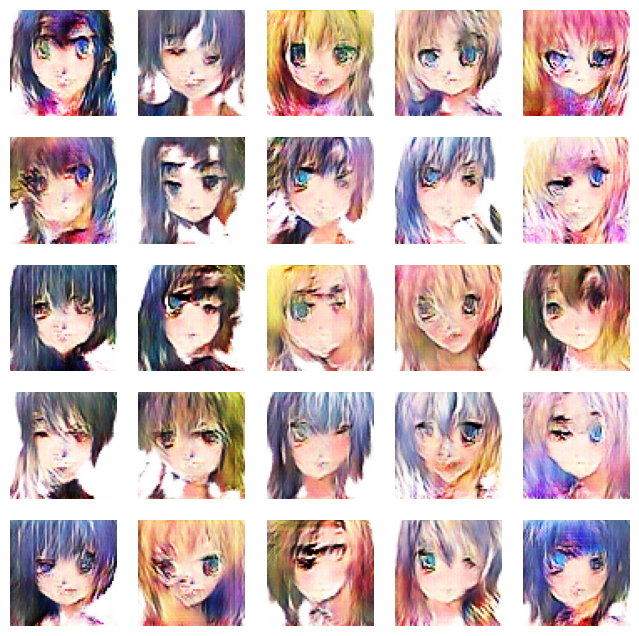

674/674 [==============================] - 46s 68ms/step - d_loss: 0.6627 - g_loss: 1.1577
Epoch 12/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6783 - g_loss: 1.0466

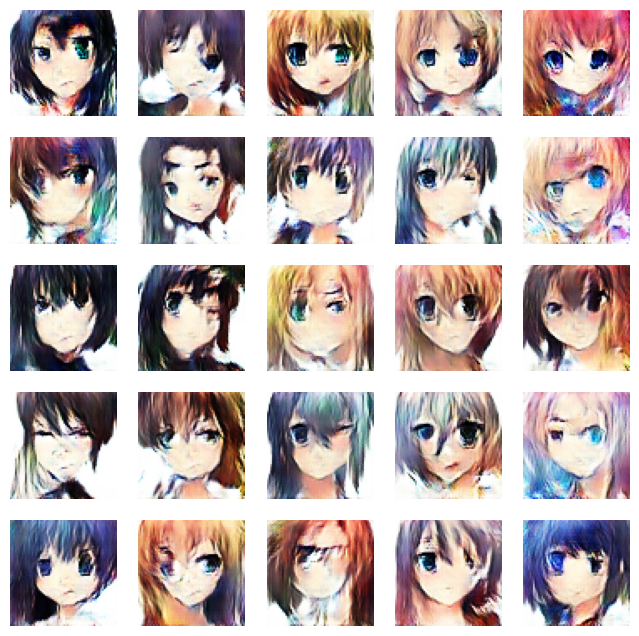

674/674 [==============================] - 46s 69ms/step - d_loss: 0.6786 - g_loss: 1.0463
Epoch 13/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6881 - g_loss: 0.9659

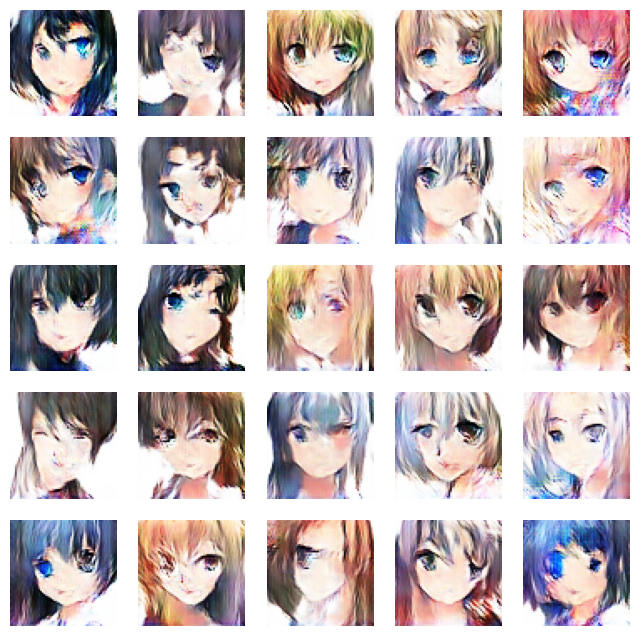

674/674 [==============================] - 46s 68ms/step - d_loss: 0.6880 - g_loss: 0.9664
Epoch 14/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6936 - g_loss: 0.9438

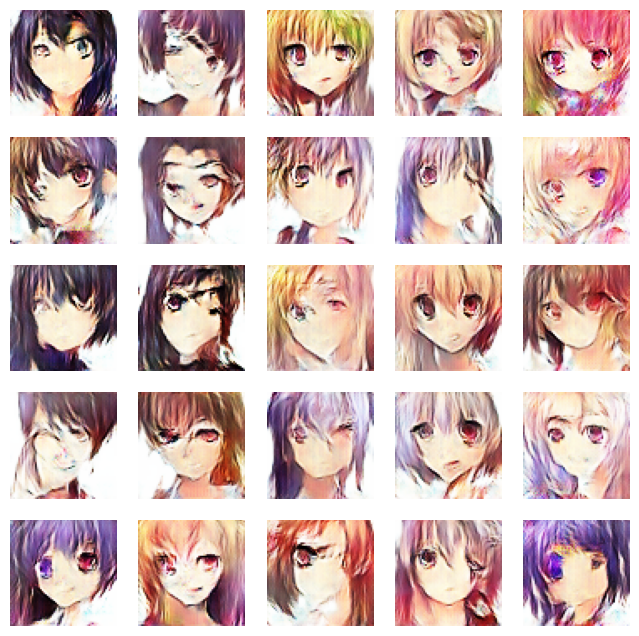

674/674 [==============================] - 46s 68ms/step - d_loss: 0.6936 - g_loss: 0.9437
Epoch 15/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6886 - g_loss: 0.9119

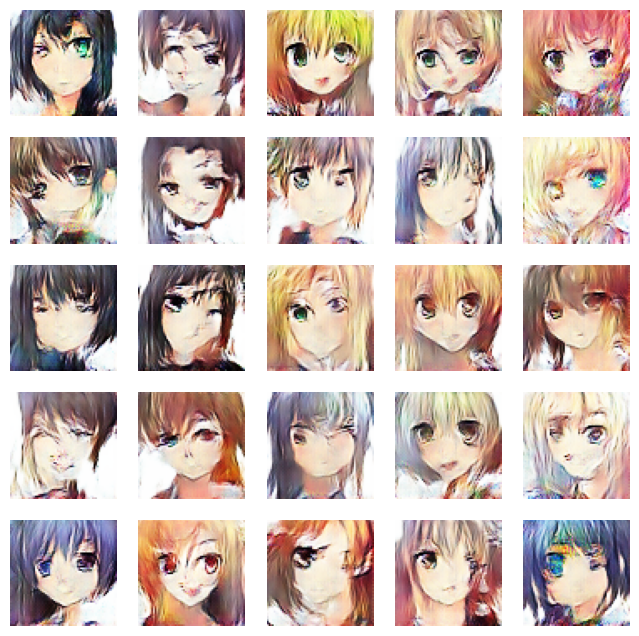

674/674 [==============================] - 46s 68ms/step - d_loss: 0.6886 - g_loss: 0.9116
Epoch 16/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6871 - g_loss: 0.8965

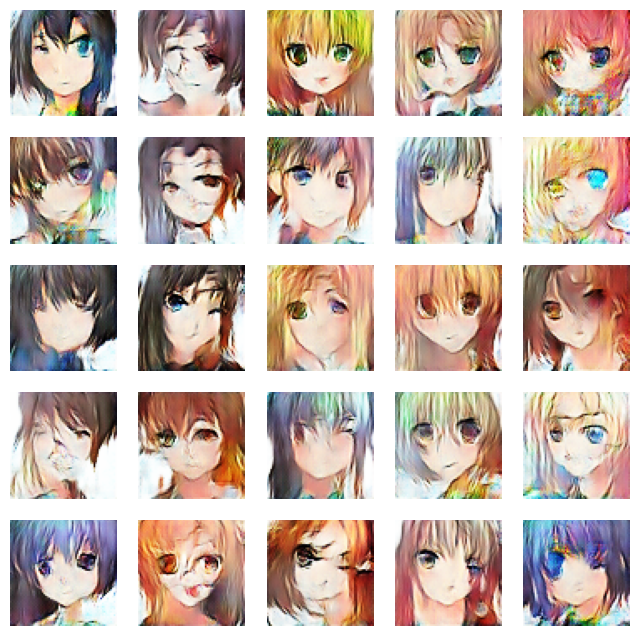

674/674 [==============================] - 46s 68ms/step - d_loss: 0.6872 - g_loss: 0.8965
Epoch 17/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6855 - g_loss: 0.8875

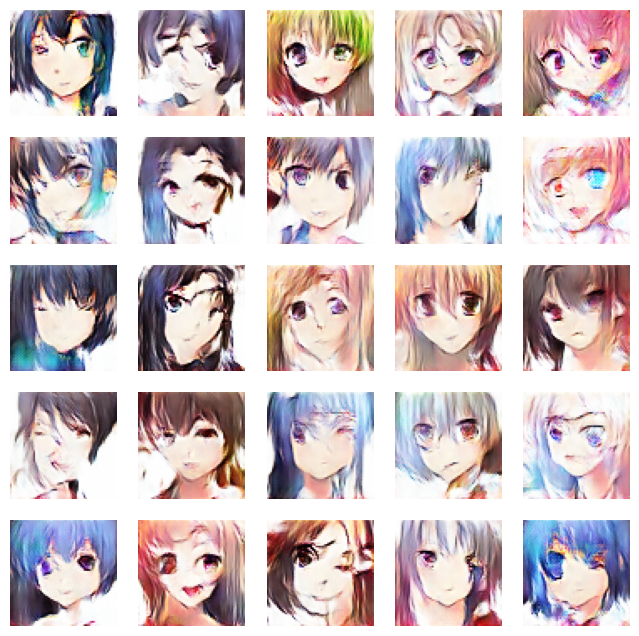

674/674 [==============================] - 46s 68ms/step - d_loss: 0.6856 - g_loss: 0.8877
Epoch 18/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6925 - g_loss: 0.8718

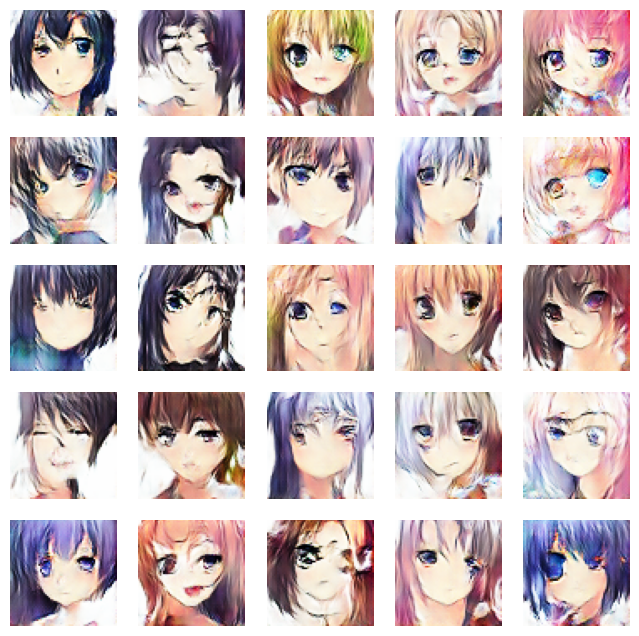

674/674 [==============================] - 46s 68ms/step - d_loss: 0.6924 - g_loss: 0.8714
Epoch 19/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6866 - g_loss: 0.8559

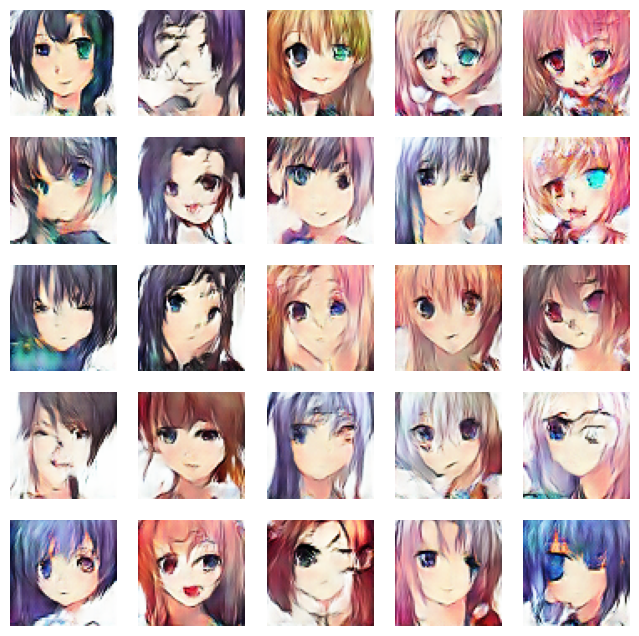

674/674 [==============================] - 46s 68ms/step - d_loss: 0.6865 - g_loss: 0.8559
Epoch 20/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6838 - g_loss: 0.8583

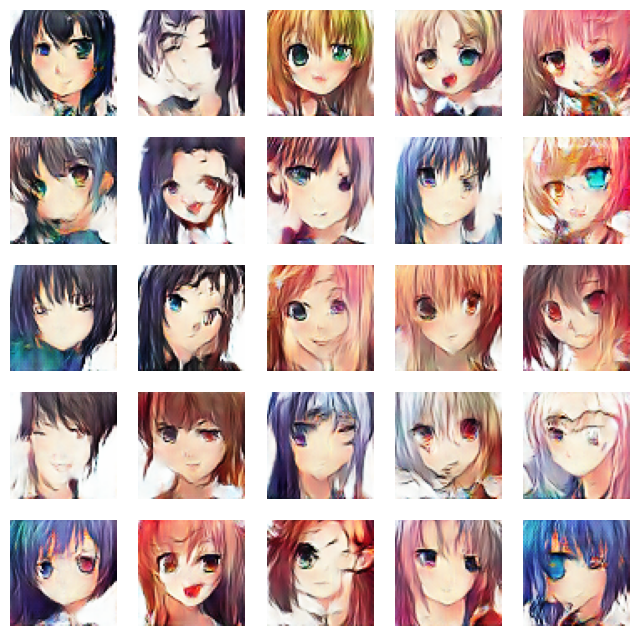

674/674 [==============================] - 46s 68ms/step - d_loss: 0.6837 - g_loss: 0.8584
Epoch 21/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6840 - g_loss: 0.8504

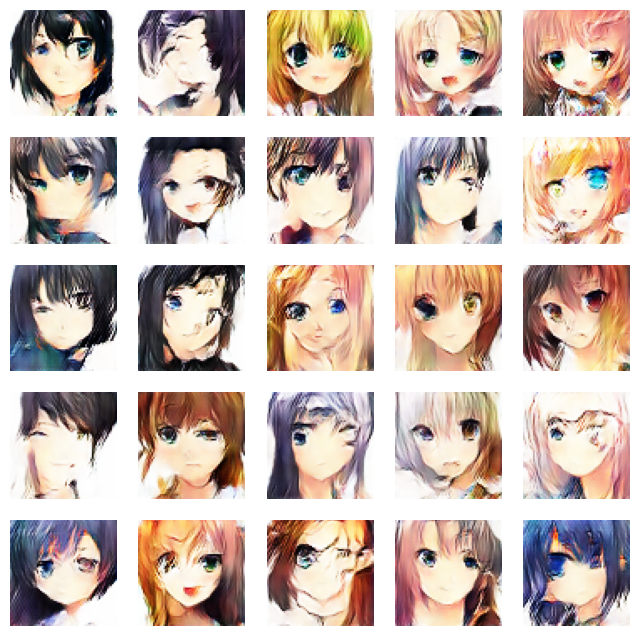

674/674 [==============================] - 45s 67ms/step - d_loss: 0.6839 - g_loss: 0.8504
Epoch 22/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6830 - g_loss: 0.8451

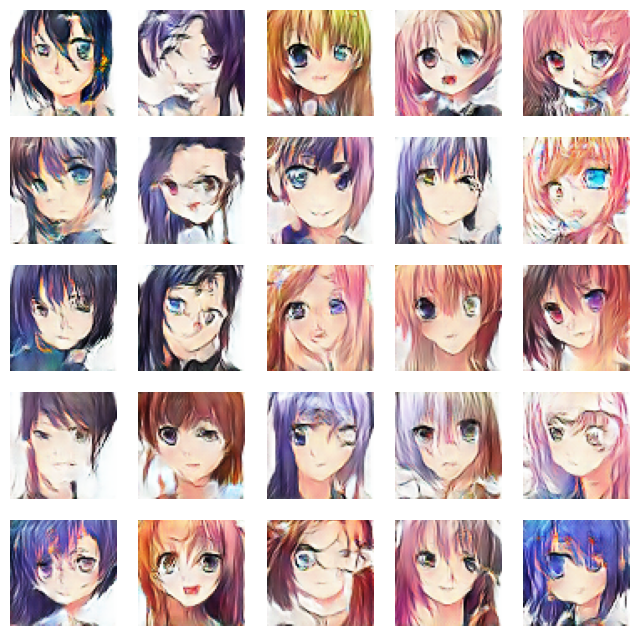

674/674 [==============================] - 46s 68ms/step - d_loss: 0.6829 - g_loss: 0.8450
Epoch 23/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6811 - g_loss: 0.8458

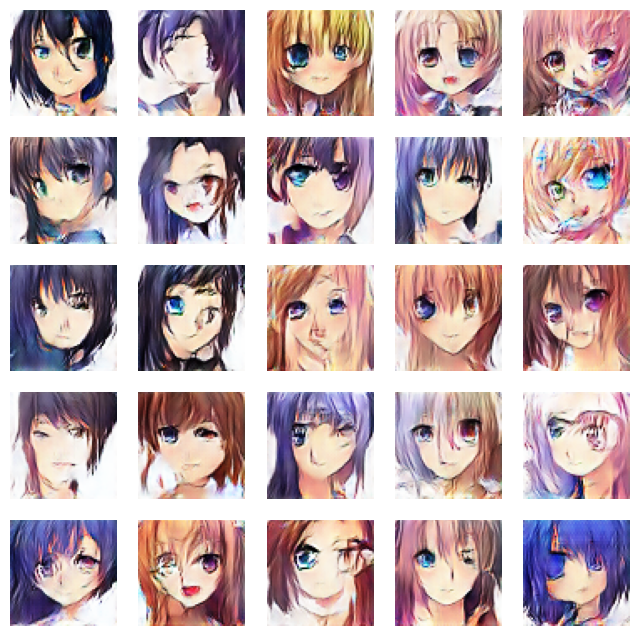

674/674 [==============================] - 46s 68ms/step - d_loss: 0.6812 - g_loss: 0.8455
Epoch 24/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6791 - g_loss: 0.8460

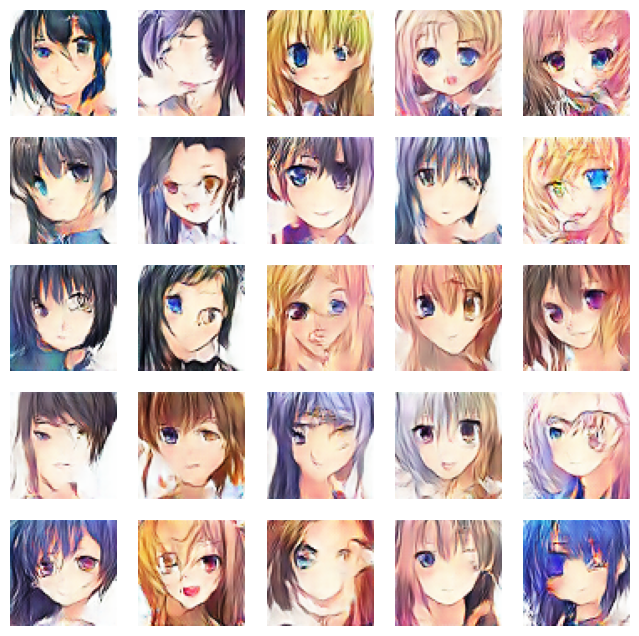

674/674 [==============================] - 46s 68ms/step - d_loss: 0.6792 - g_loss: 0.8460
Epoch 25/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6741 - g_loss: 0.8498

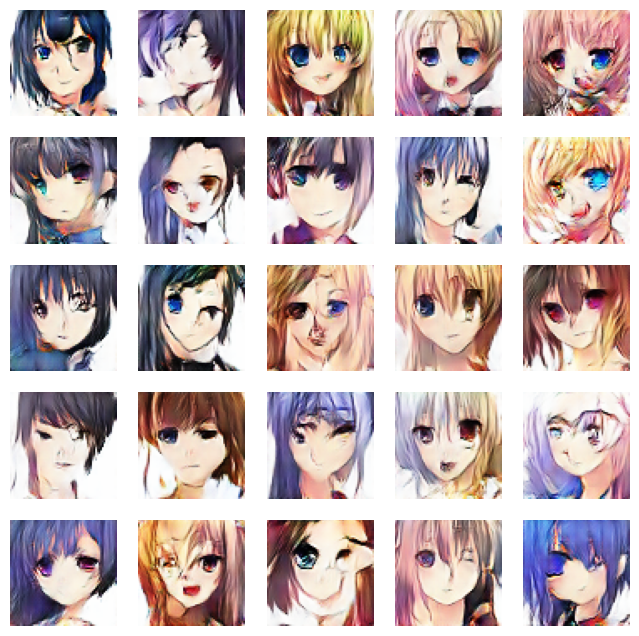

674/674 [==============================] - 46s 68ms/step - d_loss: 0.6741 - g_loss: 0.8498
Epoch 26/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6717 - g_loss: 0.8585

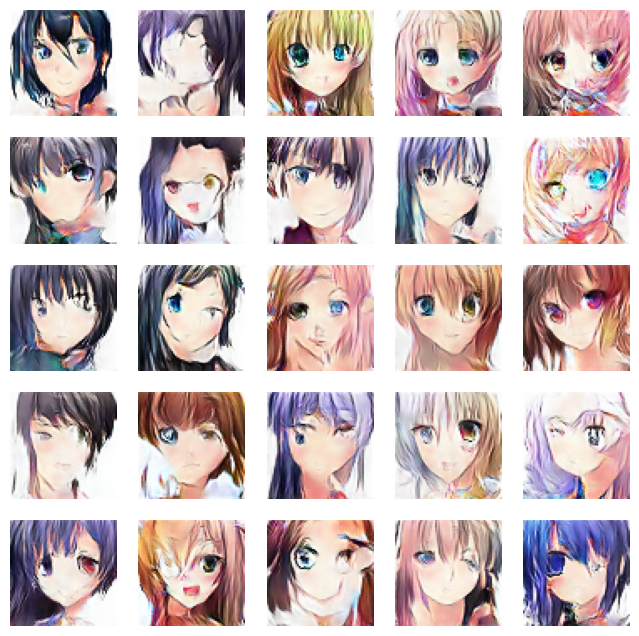

674/674 [==============================] - 46s 68ms/step - d_loss: 0.6718 - g_loss: 0.8585
Epoch 27/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6696 - g_loss: 0.8654

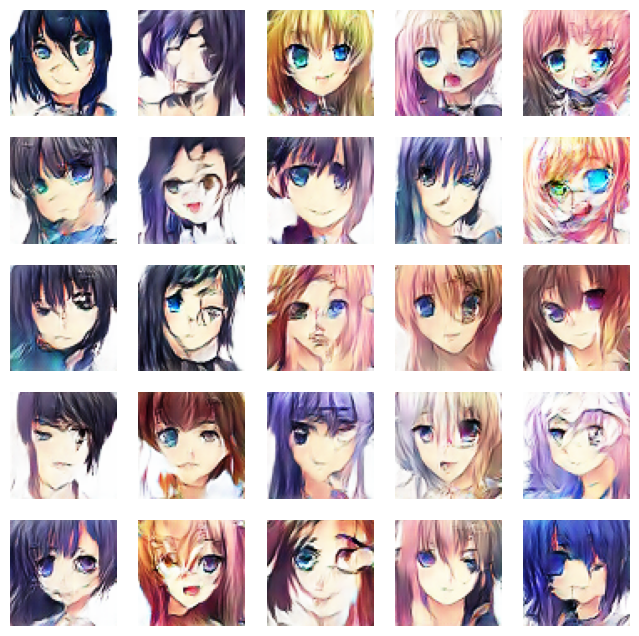

674/674 [==============================] - 46s 68ms/step - d_loss: 0.6696 - g_loss: 0.8653
Epoch 28/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6642 - g_loss: 0.8694

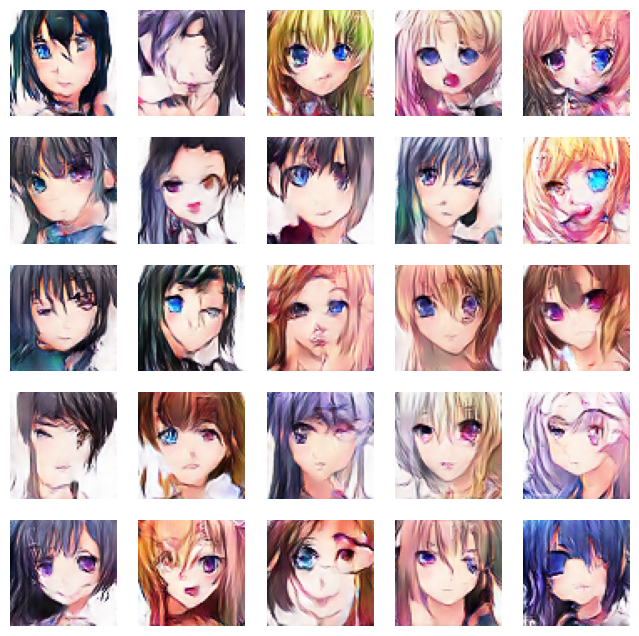

674/674 [==============================] - 46s 69ms/step - d_loss: 0.6643 - g_loss: 0.8693
Epoch 29/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6629 - g_loss: 0.8823

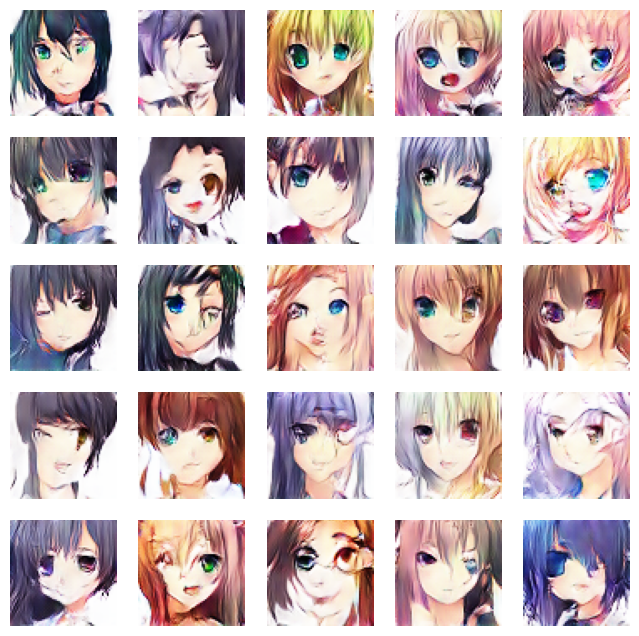

674/674 [==============================] - 46s 68ms/step - d_loss: 0.6629 - g_loss: 0.8825
Epoch 30/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6557 - g_loss: 0.8910

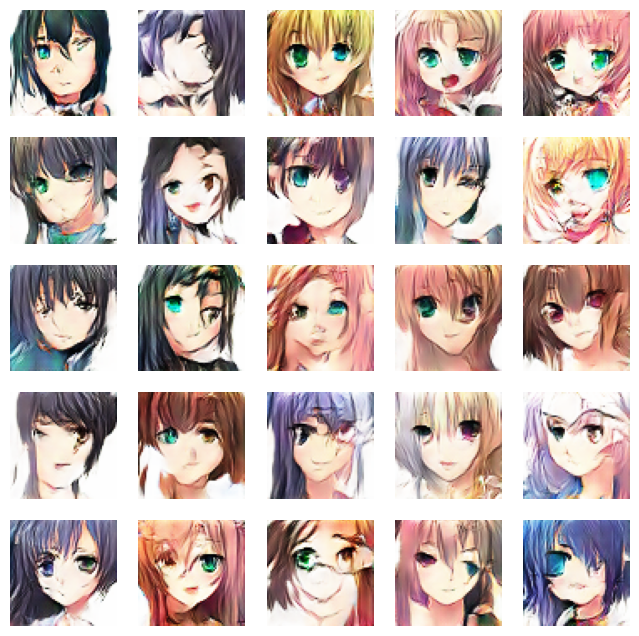

674/674 [==============================] - 46s 68ms/step - d_loss: 0.6558 - g_loss: 0.8909
Epoch 31/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6555 - g_loss: 0.9010

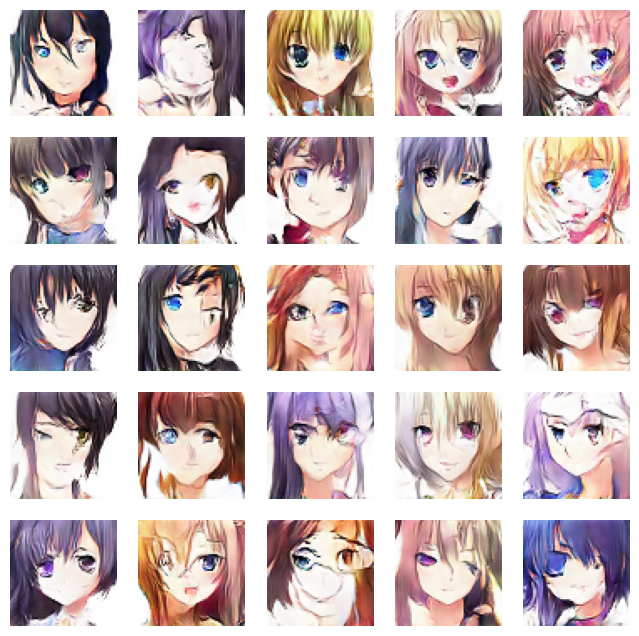

674/674 [==============================] - 46s 68ms/step - d_loss: 0.6555 - g_loss: 0.9015
Epoch 32/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6492 - g_loss: 0.9096

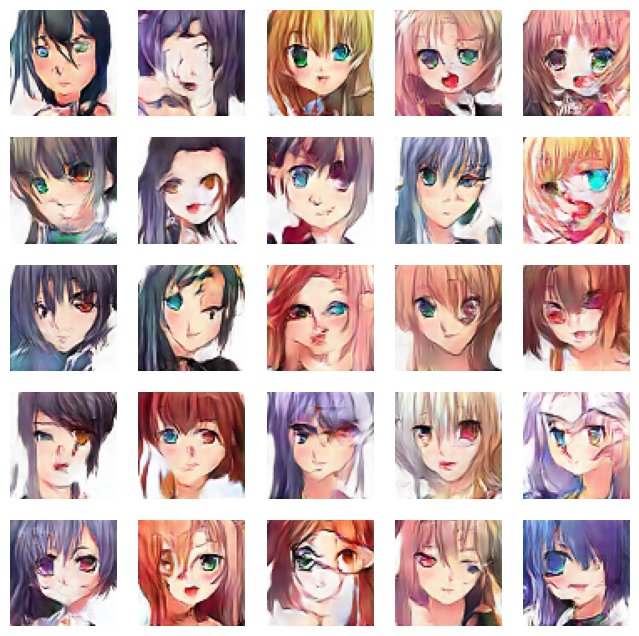

674/674 [==============================] - 46s 68ms/step - d_loss: 0.6492 - g_loss: 0.9097
Epoch 33/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6456 - g_loss: 0.9210

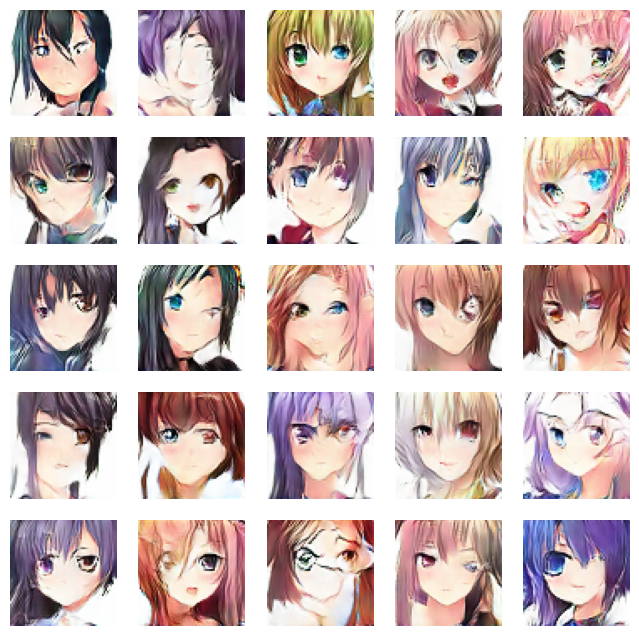

674/674 [==============================] - 46s 68ms/step - d_loss: 0.6455 - g_loss: 0.9210
Epoch 34/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6409 - g_loss: 0.9332

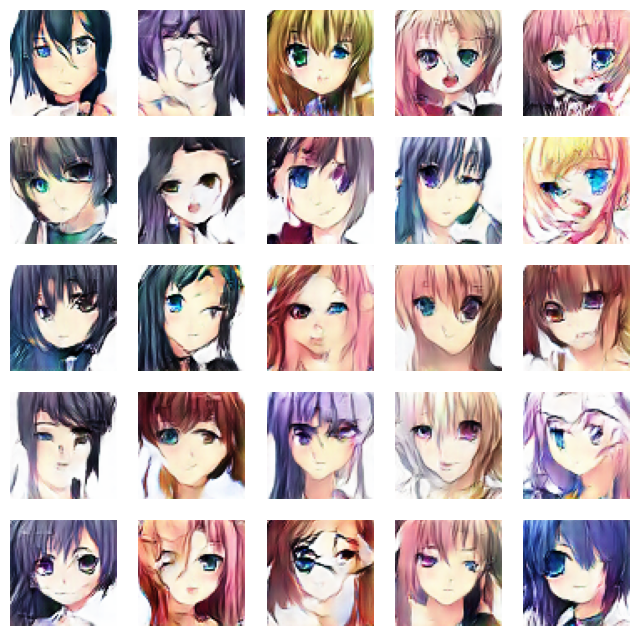

674/674 [==============================] - 46s 69ms/step - d_loss: 0.6409 - g_loss: 0.9330
Epoch 35/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6396 - g_loss: 0.9389

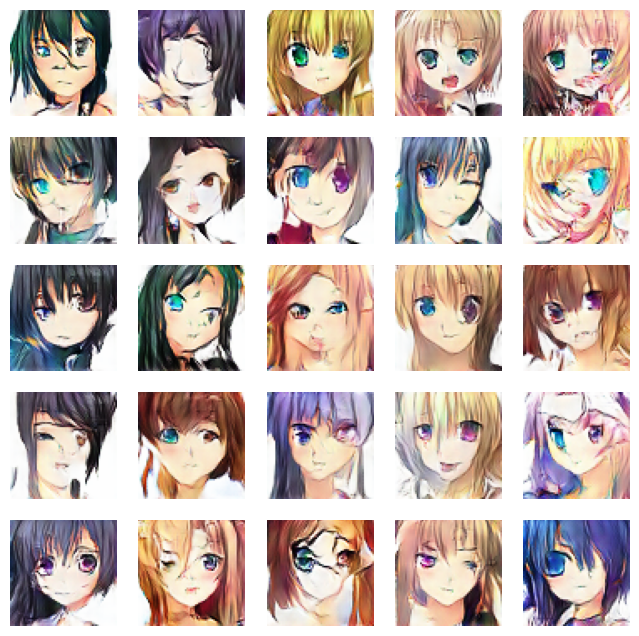

674/674 [==============================] - 46s 68ms/step - d_loss: 0.6395 - g_loss: 0.9393
Epoch 36/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6354 - g_loss: 0.9512

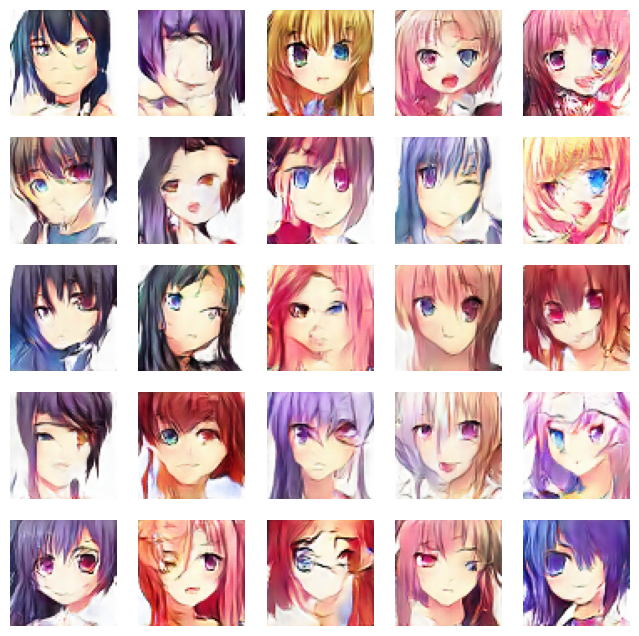

674/674 [==============================] - 46s 68ms/step - d_loss: 0.6354 - g_loss: 0.9511
Epoch 37/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6297 - g_loss: 0.9618

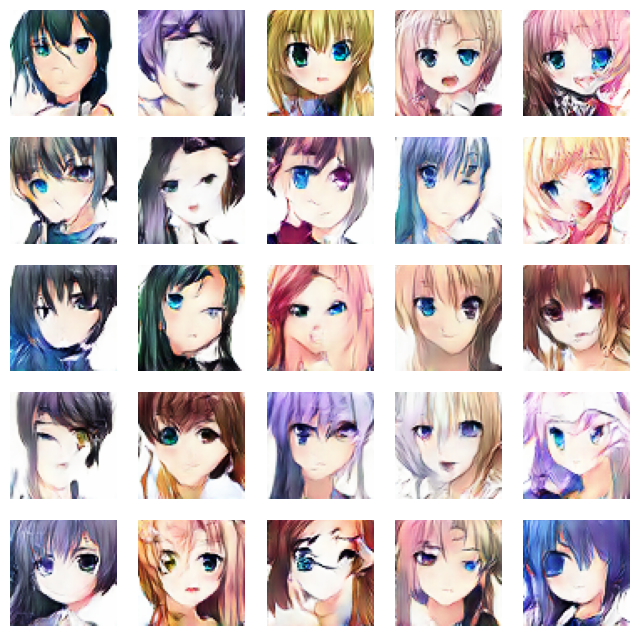

674/674 [==============================] - 46s 68ms/step - d_loss: 0.6296 - g_loss: 0.9620
Epoch 38/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6276 - g_loss: 0.9805

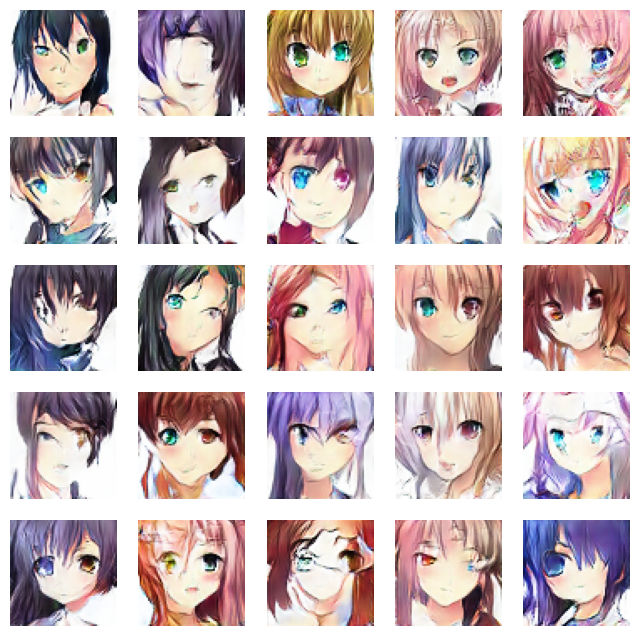

674/674 [==============================] - 46s 68ms/step - d_loss: 0.6277 - g_loss: 0.9812
Epoch 39/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6228 - g_loss: 0.9873

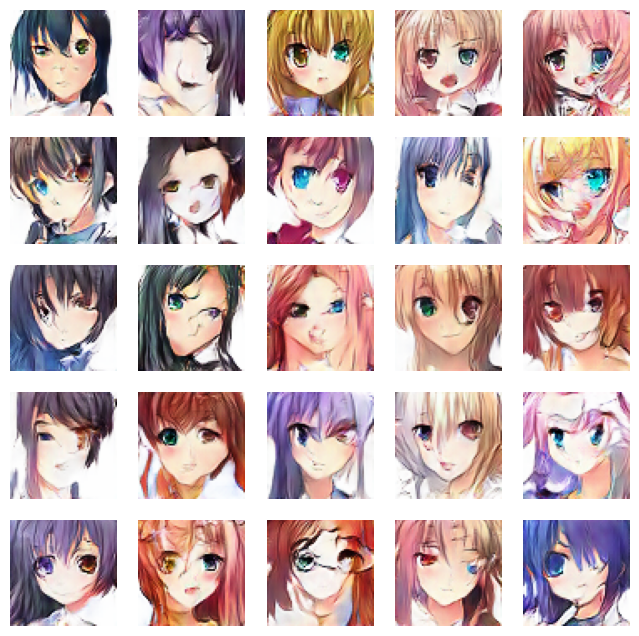

674/674 [==============================] - 46s 68ms/step - d_loss: 0.6228 - g_loss: 0.9867
Epoch 40/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6174 - g_loss: 0.9968

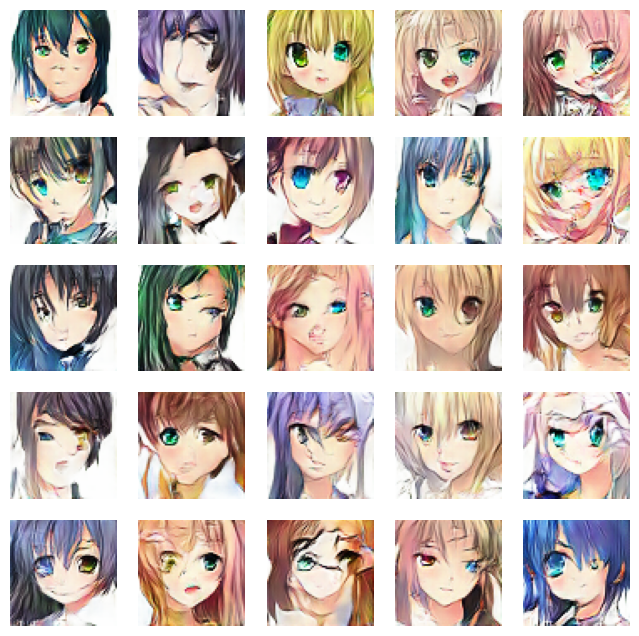

674/674 [==============================] - 46s 68ms/step - d_loss: 0.6174 - g_loss: 0.9969
Epoch 41/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6170 - g_loss: 1.0202

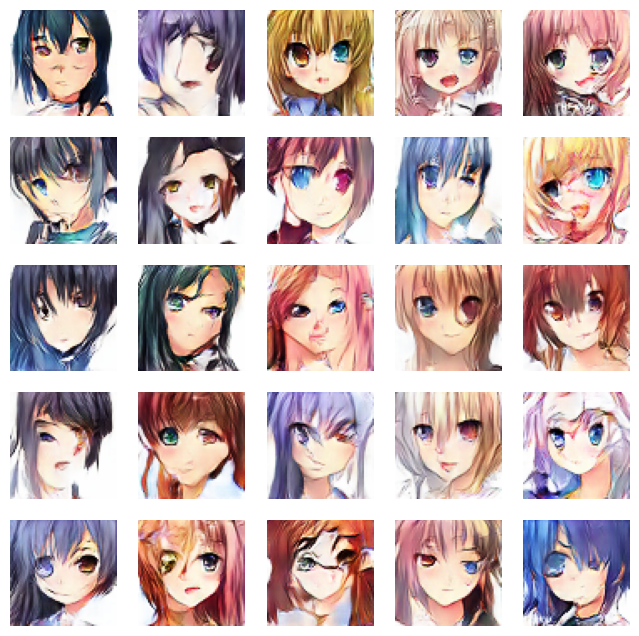

674/674 [==============================] - 46s 68ms/step - d_loss: 0.6172 - g_loss: 1.0199
Epoch 42/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6100 - g_loss: 1.0269

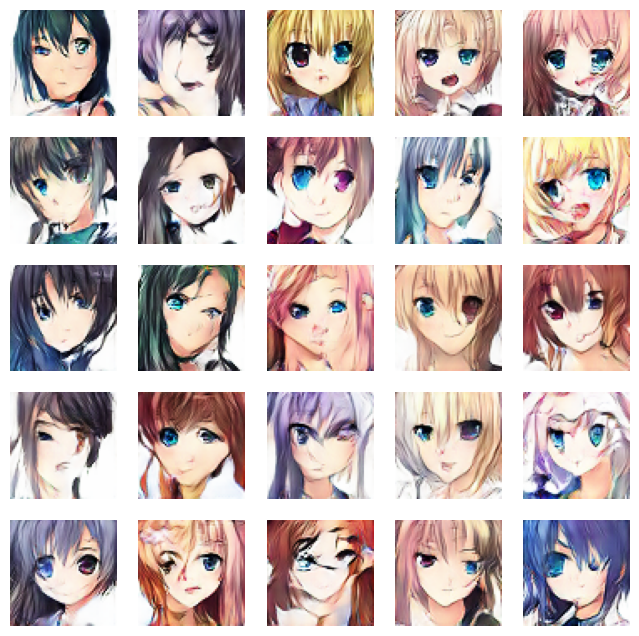

674/674 [==============================] - 46s 68ms/step - d_loss: 0.6102 - g_loss: 1.0263
Epoch 43/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6055 - g_loss: 1.0411

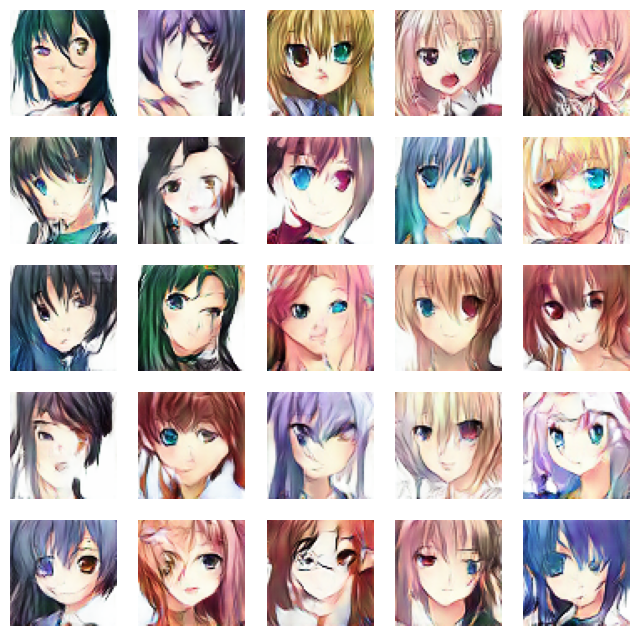

674/674 [==============================] - 46s 68ms/step - d_loss: 0.6056 - g_loss: 1.0412
Epoch 44/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6017 - g_loss: 1.0550

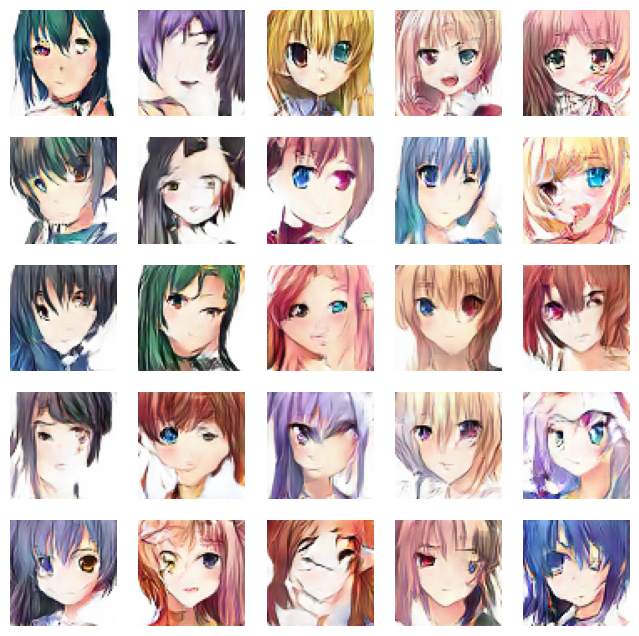

674/674 [==============================] - 46s 68ms/step - d_loss: 0.6017 - g_loss: 1.0552
Epoch 45/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.5975 - g_loss: 1.0717

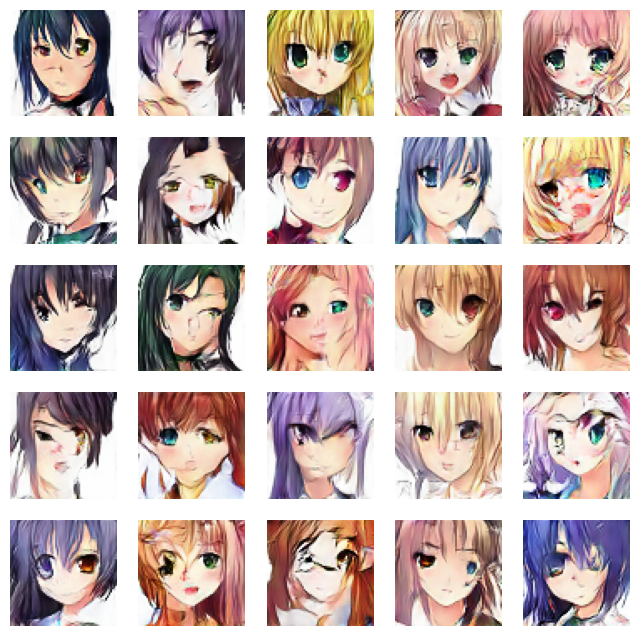

674/674 [==============================] - 46s 68ms/step - d_loss: 0.5976 - g_loss: 1.0723
Epoch 46/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.5923 - g_loss: 1.0844

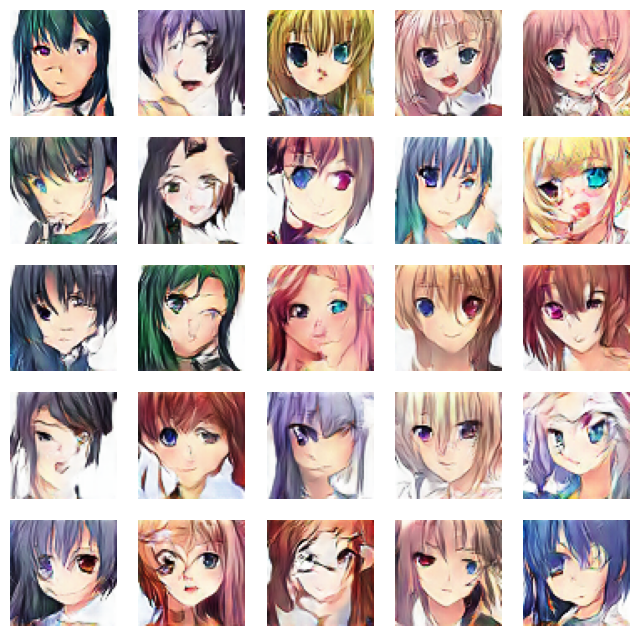

674/674 [==============================] - 45s 67ms/step - d_loss: 0.5923 - g_loss: 1.0848
Epoch 47/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.5884 - g_loss: 1.1066

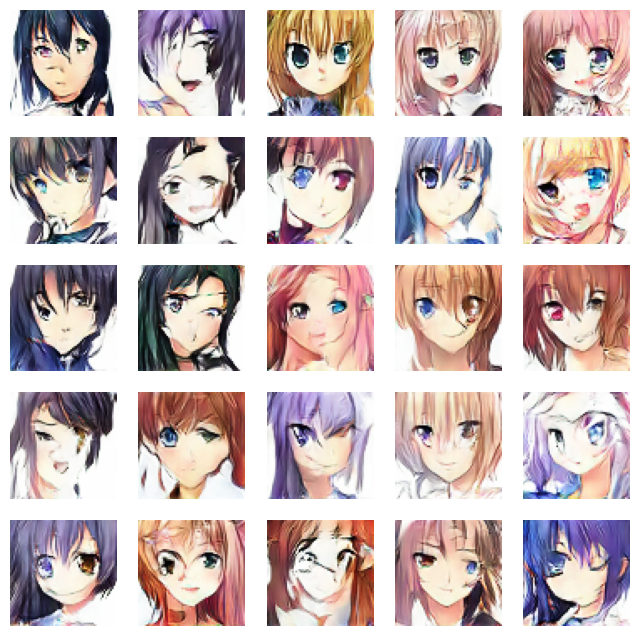

674/674 [==============================] - 46s 68ms/step - d_loss: 0.5883 - g_loss: 1.1071
Epoch 48/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.5866 - g_loss: 1.1161

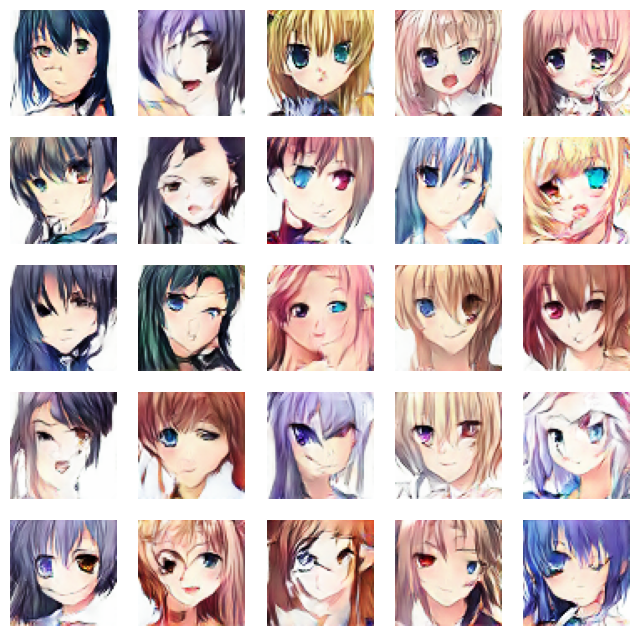

674/674 [==============================] - 45s 67ms/step - d_loss: 0.5866 - g_loss: 1.1165
Epoch 49/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.5828 - g_loss: 1.1314

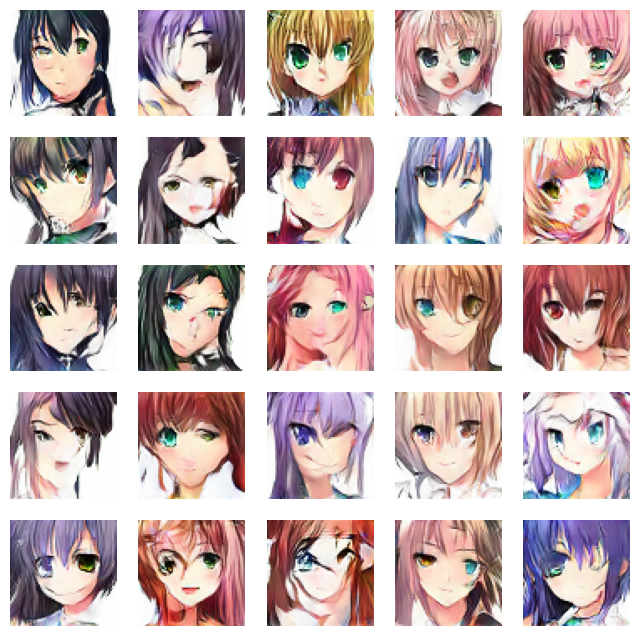

674/674 [==============================] - 46s 68ms/step - d_loss: 0.5828 - g_loss: 1.1310
Epoch 50/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.5771 - g_loss: 1.1328

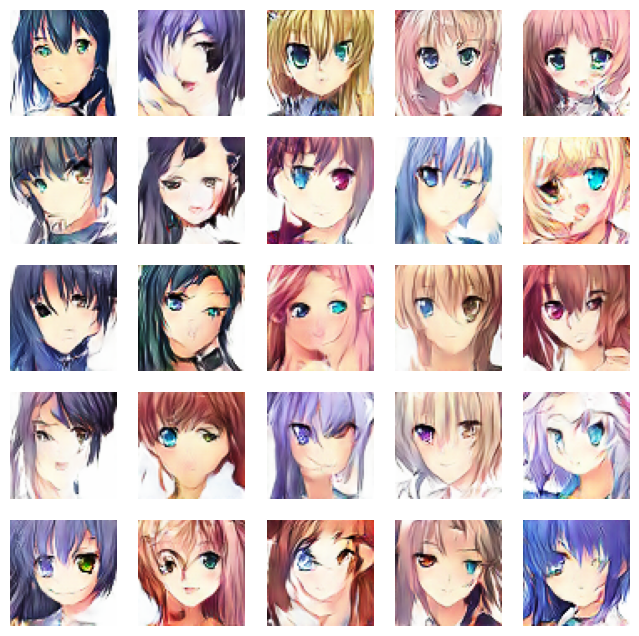

674/674 [==============================] - 45s 67ms/step - d_loss: 0.5772 - g_loss: 1.1330


In [ ]:
# Number of epochs
NUM_EPOCHS = 50

# Train DCGAN model
dcgan_model.fit(normalized_images, epochs=NUM_EPOCHS, callbacks=[DCGANMonitor()])

In [ ]:
# Save the trained generator model
dcgan_model.generator.save('anime_face_generator.h5')

# Load the saved generator model
loaded_generator = load_model('anime_face_generator.h5')